### Notebook for the integration and label transfer of CD45+ immune cells with `scANVI`

- **Developed by:** Carlos Talavera-López Ph.D
- **Würzburg Institute for Systems Immunology - Faculty of Medicine - Julius-Maximilian-Universität Würzburg**
- v240329

### Import required modules

In [1]:
import scvi
import torch
import anndata
import warnings
import numpy as np
import scanpy as sc
import pandas as pd
import plotnine as p
from pywaffle import Waffle
import matplotlib.pyplot as plt
from scib_metrics.benchmark import Benchmarker

### Set up working environment

In [2]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 180, color_map = 'magma_r', dpi_save = 300, vector_friendly = True, format = 'svg')

-----
anndata     0.10.5.post1
scanpy      1.9.8
-----
PIL                 10.2.0
absl                NA
asttokens           NA
attr                23.2.0
chex                0.1.85
comm                0.2.1
contextlib2         NA
cycler              0.12.1
cython_runtime      NA
dateutil            2.8.2
debugpy             1.8.1
decorator           5.1.1
docrep              0.3.2
etils               1.7.0
executing           2.0.1
flax                0.8.1
fsspec              2024.2.0
h5py                3.10.0
igraph              0.11.4
importlib_resources NA
ipykernel           6.29.2
ipywidgets          8.1.2
jax                 0.4.19
jaxlib              0.4.19
jedi                0.19.1
joblib              1.3.2
kiwisolver          1.4.5
lightning           2.1.4
lightning_utilities 0.10.1
llvmlite            0.42.0
matplotlib          3.8.3
mizani              0.11.0
ml_collections      NA
ml_dtypes           0.3.2
mpl_toolkits        NA
msgpack             1.0.7
mudata        

In [3]:
warnings.simplefilter(action = 'ignore')
scvi.settings.seed = 1712
%config InlineBackend.print_figure_kwargs = {'facecolor' : "w"}
%config InlineBackend.figure_format = 'retina'
torch.set_float32_matmul_precision('medium')

Seed set to 1712


In [4]:
arches_params = dict(
    use_layer_norm = "both",
    use_batch_norm = "none",
    encode_covariates = True,
    dropout_rate = 0.2,
    n_layers = 3,
)

### Read in and format individual cell compartments

- Read in CD45+ immune cells 

In [5]:
MDX_MPC = sc.read_h5ad('../../data/MDX_MPC.h5ad')
MDX_MPC.obs['genotype'] = MDX_MPC.obs['Condition'].copy()
MDX_MPC.obs['sample'] = MDX_MPC.obs['hash.ID'].copy()
MDX_MPC.obs['donor'] = MDX_MPC.obs['Sample'].copy()
MDX_MPC.obs['seed_labels'] = MDX_MPC.obs['MPC_Annotation'].copy()
MDX_MPC.obs['cell_source'] = 'HIRI-CD45+'
MDX_MPC

AnnData object with n_obs × n_vars = 6305 × 31053
    obs: 'nCount_RNA', 'nFeature_RNA', 'nCount_HTO', 'nFeature_HTO', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'hash.ID', 'nCount_ADT', 'nFeature_ADT', 'percent.mt', 'Library', 'Sample', 'Condition', 'RNA_snn_res.0.2', 'seurat_clusters', 'RNA_snn_res.0.3', 'RNA_snn_res.0.5', 'MPC_Annotation', 'genotype', 'sample', 'donor', 'seed_labels', 'cell_source'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable'
    obsm: 'X_harmony', 'X_pca', 'X_umap'

In [6]:
MDX_MPC = MDX_MPC[MDX_MPC.obs['nFeature_RNA'] > 200]
MDX_MPC = MDX_MPC[MDX_MPC.obs['nFeature_RNA'] < 4000]

MDX_MPC = MDX_MPC[MDX_MPC.obs['nCount_RNA'] < 15000]
MDX_MPC = MDX_MPC[MDX_MPC.obs['nCount_RNA'] > 200]

MDX_MPC = MDX_MPC[MDX_MPC.obs['percent.mt'] < 60]

MDX_MPC

View of AnnData object with n_obs × n_vars = 5451 × 31053
    obs: 'nCount_RNA', 'nFeature_RNA', 'nCount_HTO', 'nFeature_HTO', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'hash.ID', 'nCount_ADT', 'nFeature_ADT', 'percent.mt', 'Library', 'Sample', 'Condition', 'RNA_snn_res.0.2', 'seurat_clusters', 'RNA_snn_res.0.3', 'RNA_snn_res.0.5', 'MPC_Annotation', 'genotype', 'sample', 'donor', 'seed_labels', 'cell_source'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable'
    obsm: 'X_harmony', 'X_pca', 'X_umap'

In [7]:
MDX_POOL_NEW = sc.read_h5ad('../../data/MDX_POOL_NEW.h5ad')
MDX_POOL_NEW.obs['genotype'] = MDX_POOL_NEW.obs['Condition'].copy()
MDX_POOL_NEW.obs['sample'] = MDX_POOL_NEW.obs['hash.ID'].copy()
MDX_POOL_NEW.obs['donor'] = MDX_POOL_NEW.obs['Sample'].copy()
MDX_POOL_NEW.obs['seed_labels'] = MDX_POOL_NEW.obs['CD45_Annotation'].copy()
MDX_POOL_NEW.obs['cell_source'] = 'HIRI-CD45+'
MDX_POOL_NEW

AnnData object with n_obs × n_vars = 11098 × 31053
    obs: 'nCount_RNA', 'nFeature_RNA', 'nCount_HTO', 'nFeature_HTO', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'hash.ID', 'nCount_ADT', 'nFeature_ADT', 'percent.mt', 'Library', 'Sample', 'Condition', 'RNA_snn_res.0.2', 'seurat_clusters', 'CD45_Annotation', 'genotype', 'sample', 'donor', 'seed_labels', 'cell_source'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable'
    obsm: 'X_harmony', 'X_pca', 'X_umap'

In [8]:
MDX_POOL_NEW = MDX_POOL_NEW[MDX_POOL_NEW.obs['nFeature_RNA'] > 200]
MDX_POOL_NEW = MDX_POOL_NEW[MDX_POOL_NEW.obs['nFeature_RNA'] < 4000]

MDX_POOL_NEW = MDX_POOL_NEW[MDX_POOL_NEW.obs['nCount_RNA'] < 15000]
MDX_POOL_NEW = MDX_POOL_NEW[MDX_POOL_NEW.obs['nCount_RNA'] > 200]

MDX_POOL_NEW = MDX_POOL_NEW[MDX_POOL_NEW.obs['percent.mt'] < 60]

MDX_POOL_NEW

View of AnnData object with n_obs × n_vars = 10114 × 31053
    obs: 'nCount_RNA', 'nFeature_RNA', 'nCount_HTO', 'nFeature_HTO', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'hash.ID', 'nCount_ADT', 'nFeature_ADT', 'percent.mt', 'Library', 'Sample', 'Condition', 'RNA_snn_res.0.2', 'seurat_clusters', 'CD45_Annotation', 'genotype', 'sample', 'donor', 'seed_labels', 'cell_source'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable'
    obsm: 'X_harmony', 'X_pca', 'X_umap'

- Read in Meyer annotated PBMC cells

In [9]:
pbmc = sc.read_h5ad('../../data/meyer_nikolic_healthy_pbmc_raw.h5ad') 
pbmc

AnnData object with n_obs × n_vars = 173684 × 33559
    obs: 'orig.ident', 'Age_group', 'BMI', 'COVID_severity', 'COVID_status', 'Ethnicity', 'Group', 'Sex', 'annotation_broad', 'annotation_detailed', 'sample_id', 'seed_labels', 'donor', 'cell_states'
    var: 'name'

In [10]:
pbmc_healthy = pbmc[pbmc.obs['COVID_status'].isin(['Healthy'])]
pbmc_healthy.obs['sample'] = pbmc_healthy.obs['sample_id'].copy()
pbmc_healthy.obs['seed_labels'] = pbmc_healthy.obs['annotation_detailed'].copy()
pbmc_healthy.obs['cell_source'] = 'Sanger-Cells'
pbmc_healthy.obs['genotype'] = 'human'
pbmc_healthy

AnnData object with n_obs × n_vars = 173684 × 33559
    obs: 'orig.ident', 'Age_group', 'BMI', 'COVID_severity', 'COVID_status', 'Ethnicity', 'Group', 'Sex', 'annotation_broad', 'annotation_detailed', 'sample_id', 'seed_labels', 'donor', 'cell_states', 'sample', 'cell_source', 'genotype'
    var: 'name'

In [11]:
pbmc_healthy.var_names = [gene_name.capitalize() for gene_name in pbmc_healthy.var_names]
pbmc_healthy.var_names

Index(['Mir1302-2hg', 'Fam138a', 'Or4f5', 'Al627309.1', 'Al627309.3',
       'Al627309.2', 'Al627309.4', 'Al732372.1', 'Or4f29', 'Ac114498.1',
       ...
       'Viral-hhv-6a-(human-herpes-virus-6)',
       'Viral-hhv-6b-(human-herpes-virus-6)',
       'Viral-herpes-simplex-virus-1-(human-alphaherpesvirus-1)',
       'Viral-herpes-simplex-virus-2-(human-alphaherpesvirus-1)',
       'Viral-measles-morbillivirus', 'Viral-mumps-rubulavirus',
       'Viral-rubella',
       'Viral-varicella-zoster-virus-(vzv-human-alphaherpesvirus-3)',
       'Viral-cytomegalovieus-(cmv)', 'Viral-sars-cov2'],
      dtype='object', length=33559)

### Read in DMD query cells

In [12]:
DMD_scANVI = sc.read_h5ad('../../data/heart_mm_nuclei-23-0092_scANVI-CellStates_ctl240129.raw.h5ad')
DMD_scANVI.obs_names = [name.rsplit('-', 2)[0] for name in DMD_scANVI.obs_names]
DMD_scANVI.obs['seed_labels'] = DMD_scANVI.obs['C_scANVI'].copy()
DMD_scANVI

AnnData object with n_obs × n_vars = 112457 × 32285
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

- Subset immune compartment

In [13]:
DMD_scANVI.obs['C_scANVI'].cat.categories

Index(['DOCK4+vMØ', 'EC1_cap', 'EC3_cap', 'EC5_art', 'EC6_ven', 'EC7_atria',
       'FB1', 'FB2', 'FB3', 'NC1', 'NK_CD16hi', 'PC1_vent', 'PC2_atria',
       'PC3_str', 'SMC1_basic', 'aCM1', 'nøMo', 'vCM1', 'vCM3'],
      dtype='object')

In [14]:
DMD_immune = DMD_scANVI[DMD_scANVI.obs['C_scANVI'].isin(['DOCK4+vMØ', 'NK_CD16hi', 'nøMo'])]
DMD_immune.obs['seed_labels'] = 'Unknown'
DMD_immune

AnnData object with n_obs × n_vars = 67604 × 32285
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

### Merge cell compartments and compare with full object

In [15]:
compartments = pbmc_healthy.concatenate(MDX_POOL_NEW, DMD_immune, MDX_MPC,  
                                      batch_key = 'compartment', 
                                      batch_categories = ['pbmc_meyer', 'MDX_POOL_NEW', 'DMD_immune', 'MDX_MPC'], 
                                      join = 'inner')
#compartments.obs_names = [name.rsplit('-', 1)[0] for name in compartments.obs_names]
compartments

AnnData object with n_obs × n_vars = 256853 × 16060
    obs: 'orig.ident', 'Age_group', 'BMI', 'COVID_severity', 'COVID_status', 'Ethnicity', 'Group', 'Sex', 'annotation_broad', 'annotation_detailed', 'sample_id', 'seed_labels', 'donor', 'cell_states', 'sample', 'cell_source', 'genotype', 'nCount_RNA', 'nFeature_RNA', 'nCount_HTO', 'nFeature_HTO', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'hash.ID', 'nCount_ADT', 'nFeature_ADT', 'percent.mt', 'Library', 'Sample', 'Condition', 'RNA_snn_res.0.2', 'seurat_clusters', 'CD45_Annotation', 'cell_type', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'scrublet_score', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI', 'RNA_snn_res.0.3', 'RNA_snn_res.0.5', 'MPC_Annotation', 'compartment'
    var: 'gene_ids-D

In [16]:
compartments.obs_names

Index(['CV001_KM10202384-CV001_KM10202394_AAACCTGAGGCAGGTT-1-pbmc_meyer',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGAGTGTCCCG-1-pbmc_meyer',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGCAGATGGGT-1-pbmc_meyer',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGGTATAGTAG-1-pbmc_meyer',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGGTGTGCGTC-1-pbmc_meyer',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGGTTAAGTAG-1-pbmc_meyer',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGGTTAGATGA-1-pbmc_meyer',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGTCATTTGGG-1-pbmc_meyer',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGTCCGAAGAG-1-pbmc_meyer',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGTCTGCTTGC-1-pbmc_meyer',
       ...
       'TTTGGAGAGACTAAGT-1_2-MDX_MPC', 'TTTGGAGAGCGACTGA-1_2-MDX_MPC',
       'TTTGGAGAGGATAATC-1_2-MDX_MPC', 'TTTGGAGAGTAGGATT-1_2-MDX_MPC',
       'TTTGGAGTCTCGGCTT-1_2-MDX_MPC', 'TTTGGTTTCCATAGAC-1_2-MDX_MPC',
       'TTTGTTGAGATTCGAA-1_2-MDX_MPC

In [17]:
adata_export_raw = DMD_immune.concatenate(MDX_POOL_NEW, MDX_MPC,  
                                      batch_key = 'data_sourcecompartment', 
                                      batch_categories = ['DMD_immune', 'MDX_POOL_NEW', 'MDX_MPC'], 
                                      join = 'inner')
#adata_export_raw.obs_names = [name.rsplit('-', 1)[0] for name in adata_export_raw.obs_names]
adata_export_raw

AnnData object with n_obs × n_vars = 83169 × 27478
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI', 'nCount_RNA', 'nFeature_RNA', 'nCount_HTO', 'nFeature_HTO', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'hash.ID', 'nCount_ADT', 'nFeature_ADT', 'percent.mt', 'Library', 'Sample', 'Condition', 'RNA_snn_res.0.2', 'seurat_clusters', 'CD45_Annotation', 'RNA_snn_res.0.3', 'RNA_snn_res.0.5', 'MPC_Annotation', 'data_sourcecompartment'
    var: 'gene_ids-DMD_immune', 'feature_types-DMD_immune', 'genome-DMD_immune', 'mt-DMD_immune', 'ribo-DMD_immune', 'n_cells_by_counts-DMD_immune', 'mean_counts-D

In [18]:
adata_export_raw.obs_names

Index(['ACCCTTGAGAATCGTA-1-A9_2-DMD_immune',
       'AGGATCTCAGCCTTCT-1-A9_2-DMD_immune',
       'ATGCATGAGCTGACTT-1-A9_2-DMD_immune',
       'CACTTCGGTACCGGCT-1-A9_2-DMD_immune',
       'GACCCTTTCTTAGTTC-1-A9_2-DMD_immune',
       'AGCTACATCCTCGCAT-1-A9_2-DMD_immune',
       'TACAGGTAGAGCCGAT-1-A9_2-DMD_immune',
       'AGGATCTTCTCTCGCA-1-A9_2-DMD_immune',
       'GGTTCTCCAGCTTCCT-1-A9_2-DMD_immune',
       'GACTTCCTCCGTAGTA-1-A9_2-DMD_immune',
       ...
       'TTTGGAGAGACTAAGT-1_2-MDX_MPC', 'TTTGGAGAGCGACTGA-1_2-MDX_MPC',
       'TTTGGAGAGGATAATC-1_2-MDX_MPC', 'TTTGGAGAGTAGGATT-1_2-MDX_MPC',
       'TTTGGAGTCTCGGCTT-1_2-MDX_MPC', 'TTTGGTTTCCATAGAC-1_2-MDX_MPC',
       'TTTGTTGAGATTCGAA-1_2-MDX_MPC', 'TTTGTTGAGTGTTGTC-1_2-MDX_MPC',
       'TTTGTTGCAGGCCCTA-1_2-MDX_MPC', 'TTTGTTGGTGATATAG-1_2-MDX_MPC'],
      dtype='object', length=83169)

### Group fine grained annotations into coarse groups

In [19]:
compartments.obs['seed_labels'] = compartments.obs['seed_labels'].astype('category')
compartments.obs['seed_labels'].cat.categories

Index(['AS-DC', 'A_Res_Mac_MHCII', 'B invar', 'B n-sw mem',
       'B n-sw mem IFN stim', 'B naive', 'B naive IFN stim', 'B sw mem',
       'B_Cells', 'B_TLF_Mac', 'Baso/Eos', 'C_Ccr2+MHCII+_Mac',
       'Conventional_T', 'Cycling', 'D_Inflammatory_Mac', 'E_Isg15+',
       'F_Spp1+Gpnmb+', 'G_Ly6Chi_Mo', 'HPC', 'HPC IFN stim', 'H_Ly6Clow_Mo',
       'ILC', 'ILC2', 'I_cDC2', 'J_Mature_DC', 'K_nd1', 'L_nd2', 'Ly6Chi_Mono',
       'Ly6Clo_Mono', 'MAIT', 'M_low_quality', 'Macrophages', 'Mast/Baso',
       'Monocyte CD14', 'Monocyte CD14 IFN stim', 'Monocyte CD14 IL6',
       'Monocyte CD16', 'Monocyte CD16 IFN stim', 'Monocyte CD16+C1', 'NK',
       'NK CD56', 'NK IFN stim', 'NKT', 'Neutrophils', 'Plasma cells',
       'Plasmablasts', 'Platelets', 'Proliferating', 'RBC', 'T CD4 CTL',
       'T CD4 helper', 'T CD4 naive', 'T CD4 naive IFN stim', 'T CD8 CM',
       'T CD8 CTL', 'T CD8 CTL IFN stim', 'T CD8 EM', 'T CD8 EMRA',
       'T CD8 naive', 'T g/d', 'T reg', 'Unknown', 'cDC1', 'cDC2', 

- Remove low quality or ambiguous labels

In [20]:
compartments_clean = compartments[~compartments.obs['seed_labels'].isin(['Cycling', 'M_low_quality', 'Proliferating', 'RBC', 'low_quality_cells', 'myeloid??', 'non-immune'])]
compartments_clean

View of AnnData object with n_obs × n_vars = 254210 × 16060
    obs: 'orig.ident', 'Age_group', 'BMI', 'COVID_severity', 'COVID_status', 'Ethnicity', 'Group', 'Sex', 'annotation_broad', 'annotation_detailed', 'sample_id', 'seed_labels', 'donor', 'cell_states', 'sample', 'cell_source', 'genotype', 'nCount_RNA', 'nFeature_RNA', 'nCount_HTO', 'nFeature_HTO', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'hash.ID', 'nCount_ADT', 'nFeature_ADT', 'percent.mt', 'Library', 'Sample', 'Condition', 'RNA_snn_res.0.2', 'seurat_clusters', 'CD45_Annotation', 'cell_type', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'scrublet_score', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI', 'RNA_snn_res.0.3', 'RNA_snn_res.0.5', 'MPC_Annotation', 'compartment'
    var: 'ge

### Make uniform annotation for genotype labels

In [21]:
compartments_clean.obs['genotype'].value_counts()

genotype
human       172566
WT           49424
MdxSCID      14605
Mdx           8330
Mdx-SCID      5092
Ctrl          4193
Name: count, dtype: int64

In [22]:
trans_from=['MdxSCID', 'Mdx-SCID'],
trans_to = ['MdxSCID']

compartments_clean.obs['genotype'] = [str(i) for i in compartments_clean.obs['genotype']]
for leiden,celltype in zip(trans_from, trans_to):
    for leiden_from in leiden:
        compartments_clean.obs['genotype'][compartments_clean.obs['genotype'] == leiden_from] = celltype

In [23]:
compartments_clean.obs['genotype'].value_counts()

genotype
human      172566
WT          49424
MdxSCID     19697
Mdx          8330
Ctrl         4193
Name: count, dtype: int64

In [24]:
del(compartments_clean.obs['C_scANVI'])
compartments_clean

AnnData object with n_obs × n_vars = 254210 × 16060
    obs: 'orig.ident', 'Age_group', 'BMI', 'COVID_severity', 'COVID_status', 'Ethnicity', 'Group', 'Sex', 'annotation_broad', 'annotation_detailed', 'sample_id', 'seed_labels', 'donor', 'cell_states', 'sample', 'cell_source', 'genotype', 'nCount_RNA', 'nFeature_RNA', 'nCount_HTO', 'nFeature_HTO', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'hash.ID', 'nCount_ADT', 'nFeature_ADT', 'percent.mt', 'Library', 'Sample', 'Condition', 'RNA_snn_res.0.2', 'seurat_clusters', 'CD45_Annotation', 'cell_type', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'scrublet_score', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'RNA_snn_res.0.3', 'RNA_snn_res.0.5', 'MPC_Annotation', 'compartment'
    var: 'gene_ids-DMD_immune', 

### Visualise cell type distribution per condition

In [25]:
compartments_clean.obs['seed_labels'].value_counts()

seed_labels
Unknown          67604
T CD4 naive      32672
Monocyte CD14    20464
NK               20253
B naive          19295
                 ...  
F_Spp1+Gpnmb+       26
J_Mature_DC         24
L_nd2               18
Baso/Eos            10
HPC IFN stim         2
Name: count, Length: 62, dtype: int64

### Hamonise cell type labels

In [26]:
compartments_clean.obs['seed_labels'].cat.categories

Index(['AS-DC', 'A_Res_Mac_MHCII', 'B invar', 'B n-sw mem',
       'B n-sw mem IFN stim', 'B naive', 'B naive IFN stim', 'B sw mem',
       'B_Cells', 'B_TLF_Mac', 'Baso/Eos', 'C_Ccr2+MHCII+_Mac',
       'Conventional_T', 'D_Inflammatory_Mac', 'E_Isg15+', 'F_Spp1+Gpnmb+',
       'G_Ly6Chi_Mo', 'HPC', 'HPC IFN stim', 'H_Ly6Clow_Mo', 'ILC', 'ILC2',
       'I_cDC2', 'J_Mature_DC', 'K_nd1', 'L_nd2', 'Ly6Chi_Mono', 'Ly6Clo_Mono',
       'MAIT', 'Macrophages', 'Mast/Baso', 'Monocyte CD14',
       'Monocyte CD14 IFN stim', 'Monocyte CD14 IL6', 'Monocyte CD16',
       'Monocyte CD16 IFN stim', 'Monocyte CD16+C1', 'NK', 'NK CD56',
       'NK IFN stim', 'NKT', 'Neutrophils', 'Plasma cells', 'Plasmablasts',
       'Platelets', 'T CD4 CTL', 'T CD4 helper', 'T CD4 naive',
       'T CD4 naive IFN stim', 'T CD8 CM', 'T CD8 CTL', 'T CD8 CTL IFN stim',
       'T CD8 EM', 'T CD8 EMRA', 'T CD8 naive', 'T g/d', 'T reg', 'Unknown',
       'cDC1', 'cDC2', 'gd_T', 'pDC'],
      dtype='object')

In [27]:
trans_from = [['T CD4 CTL'],
              ['T CD4 naive', 'T CD4 naive IFN stim'],
              ['T CD4 helper'],
              ['T CD8 CTL', 'T CD8 CTL IFN stim'],
              ['T CD8 naive'],
              ['T CD8 CM'],
              ['T CD8 EM'],
              ['T CD8 EMRA'],
              ['Plasma cells', 'Plasmablasts'],
              ['B invar', 'B_Cells'],
              ['B n-sw mem', 'B n-sw mem IFN stim', 'B sw mem'],
              ['B naive', 'B naive IFN stim'],
              ['pDC'],
              ['AS-DC', 'I_cDC2', 'J_Mature_DC', 'cDC1', 'cDC2'],
              ['Mast/Baso'],
              ['Monocyte CD14', 'Monocyte CD14 IFN stim', 'Monocyte CD14 IL6'],
              ['Monocyte CD16', 'Monocyte CD16 IFN stim', 'Monocyte CD16+C1'],
              ['G_Ly6Chi_Mo', 'Ly6Chi_Mono'],
              ['H_Ly6Clow_Mo', 'Ly6Clo_Mono'],
              ['A_Res_Mac_MHCII'], 
              ['B_TLF_Mac'], 
              ['C_Ccr2+MHCII+_Mac'], 
              ['D_Inflammatory_Mac'], 
              ['E_Isg15+'], 
              ['F_Spp1+Gpnmb+'],
              ['NK', 'NK IFN stim'],
              ['NK CD56'],
              ['NK_CD16hi'],
              ['NKT'],
              ['DOCK4+vMØ'],
              ['T g/d', 'gd_T'],
              ['T reg'],
              ['ILC', 'ILC2'],
              ['HPC', 'HPC IFN stim', 'K_nd1', 'L_nd2', 'Unknown', 'Conventional_T', 'nøMo', 'Macrophages', 'MAIT']]

trans_to = ['CD4+T', 'CD4+Tnaive', 'Th', 'CD8+T', 'CD8+Tnaive', 'CD8+Tcm', 'CD8+Tem', 'CD8+Temra', 'Plasma', 'B_cells', 'B_mem', 'B_naive', 'pDC', 'DC',  'Mast', 'CD14+Mo', 'CD16+Mo', 'Ly6ChiMo', 'Ly6CloMo',  'MHCII+MØtr', 'TLF+MØ', 'Ccr2+MHCII+MØ', 'MØinf', 'Isg15+MØ', 'Spp1+Gpnmb+MØ', 'NK', 'CD56+NK', 'CD16+NK', 'NKT','DOCK4+MØ', 'gdT', 'Treg', 'ILC', 'Unknown']

compartments_clean.obs['seed_labels'] = [str(i) for i in compartments_clean.obs['seed_labels']]
for leiden,celltype in zip(trans_from, trans_to):
    for leiden_from in leiden:
        compartments_clean.obs['seed_labels'][compartments_clean.obs['seed_labels'] == leiden_from] = celltype

- The label 'Macrophages' is very unspecific and takes a lot of cells. To allow for other detailed annotations to be mapped, I will label them as 'Unknown'

In [28]:
compartments_clean.obs['seed_labels'] = compartments_clean.obs['seed_labels'].astype('category')
compartments_clean.obs['seed_labels'].cat.categories

Index(['B_cells', 'B_mem', 'B_naive', 'Baso/Eos', 'CD14+Mo', 'CD16+Mo',
       'CD4+T', 'CD4+Tnaive', 'CD56+NK', 'CD8+T', 'CD8+Tcm', 'CD8+Tem',
       'CD8+Temra', 'CD8+Tnaive', 'Ccr2+MHCII+MØ', 'DC', 'ILC', 'Isg15+MØ',
       'Ly6ChiMo', 'Ly6CloMo', 'MHCII+MØtr', 'Mast', 'MØinf', 'NK', 'NKT',
       'Neutrophils', 'Plasma', 'Platelets', 'Spp1+Gpnmb+MØ', 'TLF+MØ', 'Th',
       'Treg', 'Unknown', 'gdT', 'pDC'],
      dtype='object')

In [29]:
pd.crosstab(compartments_clean.obs['seed_labels'], compartments_clean.obs['genotype'])

genotype,Ctrl,Mdx,MdxSCID,WT,human
seed_labels,,,,,
B_cells,470,510,0,0,869
B_mem,0,0,0,0,5223
B_naive,0,0,0,0,20040
Baso/Eos,0,0,0,0,10
CD14+Mo,0,0,0,0,23100
CD16+Mo,0,0,0,0,5537
CD4+T,0,0,0,0,1331
CD4+Tnaive,0,0,0,0,34532
CD56+NK,0,0,0,0,2353


### Read in other unannotated dataset and split into groups

In [30]:
compartments_clean.obs['genotype'].value_counts()

genotype
human      172566
WT          49424
MdxSCID     19697
Mdx          8330
Ctrl         4193
Name: count, dtype: int64

In [31]:
reference = compartments_clean[compartments_clean.obs['genotype'].isin(['Ctrl', 'human'])]
reference

View of AnnData object with n_obs × n_vars = 176759 × 16060
    obs: 'orig.ident', 'Age_group', 'BMI', 'COVID_severity', 'COVID_status', 'Ethnicity', 'Group', 'Sex', 'annotation_broad', 'annotation_detailed', 'sample_id', 'seed_labels', 'donor', 'cell_states', 'sample', 'cell_source', 'genotype', 'nCount_RNA', 'nFeature_RNA', 'nCount_HTO', 'nFeature_HTO', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'hash.ID', 'nCount_ADT', 'nFeature_ADT', 'percent.mt', 'Library', 'Sample', 'Condition', 'RNA_snn_res.0.2', 'seurat_clusters', 'CD45_Annotation', 'cell_type', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'scrublet_score', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'RNA_snn_res.0.3', 'RNA_snn_res.0.5', 'MPC_Annotation', 'compartment'
    var: 'gene_ids-DMD_i

In [32]:
query = compartments_clean[~compartments_clean.obs['genotype'].isin(['Ctrl', 'human'])]
query.obs['seed_labels'] = 'Unknown'
query

AnnData object with n_obs × n_vars = 77451 × 16060
    obs: 'orig.ident', 'Age_group', 'BMI', 'COVID_severity', 'COVID_status', 'Ethnicity', 'Group', 'Sex', 'annotation_broad', 'annotation_detailed', 'sample_id', 'seed_labels', 'donor', 'cell_states', 'sample', 'cell_source', 'genotype', 'nCount_RNA', 'nFeature_RNA', 'nCount_HTO', 'nFeature_HTO', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'hash.ID', 'nCount_ADT', 'nFeature_ADT', 'percent.mt', 'Library', 'Sample', 'Condition', 'RNA_snn_res.0.2', 'seurat_clusters', 'CD45_Annotation', 'cell_type', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'scrublet_score', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'RNA_snn_res.0.3', 'RNA_snn_res.0.5', 'MPC_Annotation', 'compartment'
    var: 'gene_ids-DMD_immune', '

In [33]:
adata = reference.concatenate(query, batch_key = 'batch', batch_categories = ['reference', 'query'], join = 'inner')
adata

AnnData object with n_obs × n_vars = 254210 × 16060
    obs: 'orig.ident', 'Age_group', 'BMI', 'COVID_severity', 'COVID_status', 'Ethnicity', 'Group', 'Sex', 'annotation_broad', 'annotation_detailed', 'sample_id', 'seed_labels', 'donor', 'cell_states', 'sample', 'cell_source', 'genotype', 'nCount_RNA', 'nFeature_RNA', 'nCount_HTO', 'nFeature_HTO', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'hash.ID', 'nCount_ADT', 'nFeature_ADT', 'percent.mt', 'Library', 'Sample', 'Condition', 'RNA_snn_res.0.2', 'seurat_clusters', 'CD45_Annotation', 'cell_type', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'scrublet_score', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'RNA_snn_res.0.3', 'RNA_snn_res.0.5', 'MPC_Annotation', 'compartment'
    var: 'gene_ids-DMD_immune', 

- Clean merged object

In [34]:
del(adata.obs['Condition'])
del(adata.obs['hash.ID'])
del(adata.obs['Sample'])
del(adata.obs['HTO_maxID'])
del(adata.obs['HTO_secondID'])
del(adata.obs['HTO_margin'])
del(adata.obs['nCount_RNA'])
del(adata.obs['nFeature_RNA'])
del(adata.obs['nCount_ADT'])
del(adata.obs['nFeature_ADT'])
del(adata.obs['percent.mt'])
del(adata.obs['RNA_snn_res.0.2'])
del(adata.obs['seurat_clusters'])
del(adata.obs['RNA_snn_res.0.3'])
del(adata.obs['RNA_snn_res.0.5'])
adata

AnnData object with n_obs × n_vars = 254210 × 16060
    obs: 'orig.ident', 'Age_group', 'BMI', 'COVID_severity', 'COVID_status', 'Ethnicity', 'Group', 'Sex', 'annotation_broad', 'annotation_detailed', 'sample_id', 'seed_labels', 'donor', 'cell_states', 'sample', 'cell_source', 'genotype', 'nCount_HTO', 'nFeature_HTO', 'HTO_classification', 'Library', 'CD45_Annotation', 'cell_type', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'scrublet_score', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'MPC_Annotation', 'compartment'
    var: 'gene_ids-DMD_immune', 'feature_types-DMD_immune', 'genome-DMD_immune', 'mt-DMD_immune', 'ribo-DMD_immune', 'n_cells_by_counts-DMD_immune', 'mean_counts-DMD_immune', 'pct_dropout_by_counts-DMD_immune', 'total_counts-DMD_immune', 'vst.mean-MDX_MPC', '

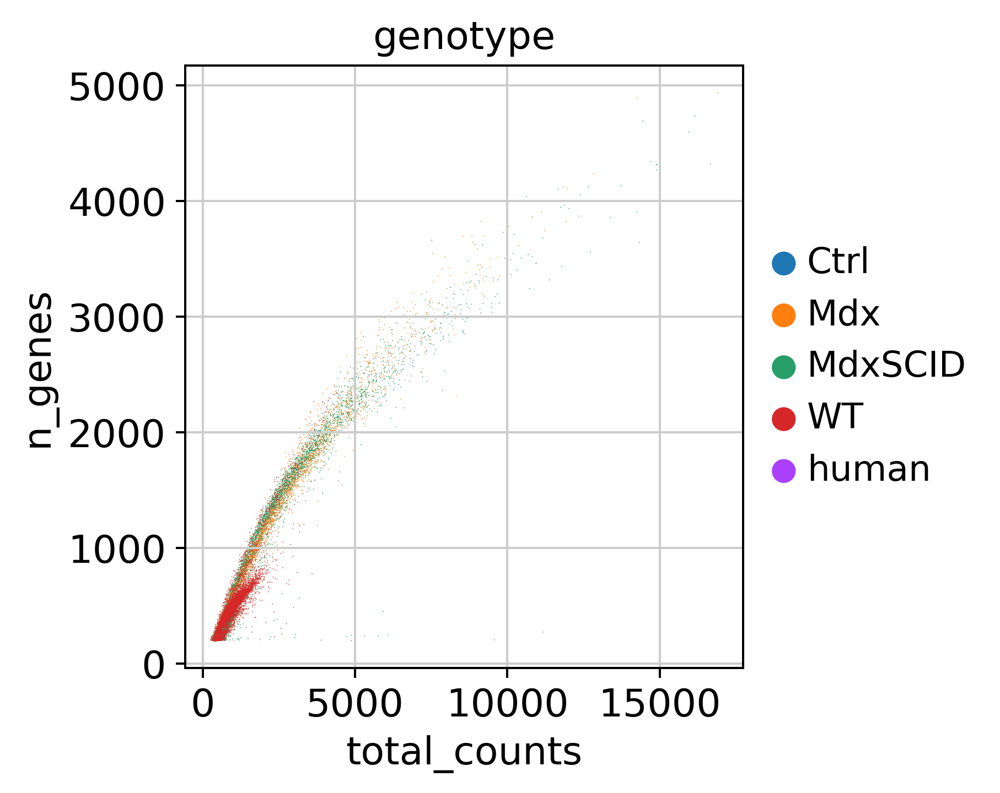

In [35]:
sc.pl.scatter(adata, x = 'total_counts', y = 'n_genes', color = "genotype", frameon = False)

In [36]:
adata.obs['genotype'].value_counts()

genotype
human      172566
WT          49424
MdxSCID     19697
Mdx          8330
Ctrl         4193
Name: count, dtype: int64

In [37]:
adata.obs['sample'].value_counts()

sample
A10_2               48454
B1_2                11984
NP18                 9663
NP13                 8919
AN13                 8220
NP23                 8004
NP24                 7357
AN12                 7182
AN7                  7072
NP19                 7004
NP28                 6810
NP17                 6340
NP39                 6089
AN2                  5969
NP44                 5870
NP36                 5837
NP22                 5511
NP27                 5282
NP31                 5002
NP21                 4755
NP37                 4636
AN6                  4269
AN9                  4141
AN5                  3936
NP41                 3879
NP30                 3861
NP32                 3740
NP15                 3602
NP26                 3528
NP20                 3321
NP38                 3206
B2_2                 2621
AN14                 2253
A11_2                1902
NP16                 1844
AN11                 1840
A12_2                1673
NP35                 1671
Hasht

### Select HVGs

In [38]:
adata_raw = adata.copy()
adata.layers['counts'] = adata.X.copy()

sc.pp.highly_variable_genes(
    adata,
    flavor = "seurat_v3",
    n_top_genes = 8000,
    layer = "counts",
    batch_key = "sample",
    subset = True
)
adata

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


AnnData object with n_obs × n_vars = 254210 × 8000
    obs: 'orig.ident', 'Age_group', 'BMI', 'COVID_severity', 'COVID_status', 'Ethnicity', 'Group', 'Sex', 'annotation_broad', 'annotation_detailed', 'sample_id', 'seed_labels', 'donor', 'cell_states', 'sample', 'cell_source', 'genotype', 'nCount_HTO', 'nFeature_HTO', 'HTO_classification', 'Library', 'CD45_Annotation', 'cell_type', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'scrublet_score', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'MPC_Annotation', 'compartment'
    var: 'gene_ids-DMD_immune', 'feature_types-DMD_immune', 'genome-DMD_immune', 'mt-DMD_immune', 'ribo-DMD_immune', 'n_cells_by_counts-DMD_immune', 'mean_counts-DMD_immune', 'pct_dropout_by_counts-DMD_immune', 'total_counts-DMD_immune', 'vst.mean-MDX_MPC', 'v

### Transfer of annotation with scANVI

In [39]:
scvi.model.SCVI.setup_anndata(adata,
                              batch_key = "sample", 
                            categorical_covariate_keys = ["donor", "cell_source"], 
                            labels_key = "seed_labels", 
                            layer = 'counts')

An NVIDIA GPU may be present on this machine, but a CUDA-enabled jaxlib is not installed. Falling back to cpu.


In [40]:
scvi_model = scvi.model.SCVI(adata, 
                             n_latent = 50, 
                             n_layers = 3, 
                             dispersion = 'gene-batch', 
                             gene_likelihood = 'nb')

In [41]:
scvi_model.train(20, 
                 check_val_every_n_epoch = 1, 
                 enable_progress_bar = True, 
                 accelerator = 'gpu',
                 devices = [1])

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]


Epoch 20/20: 100%|██████████| 20/20 [03:14<00:00,  9.05s/it, v_num=1, train_loss_step=1.45e+3, train_loss_epoch=1.54e+3]

`Trainer.fit` stopped: `max_epochs=20` reached.


Epoch 20/20: 100%|██████████| 20/20 [03:14<00:00,  9.73s/it, v_num=1, train_loss_step=1.45e+3, train_loss_epoch=1.54e+3]


In [42]:
adata.obsm["X_scVI"] = scvi_model.get_latent_representation(adata)

### Evaluate model performance using the [_Svensson_](https://www.nxn.se/valent/2023/8/10/training-scvi-posterior-predictive-distributions-over-epochs) method

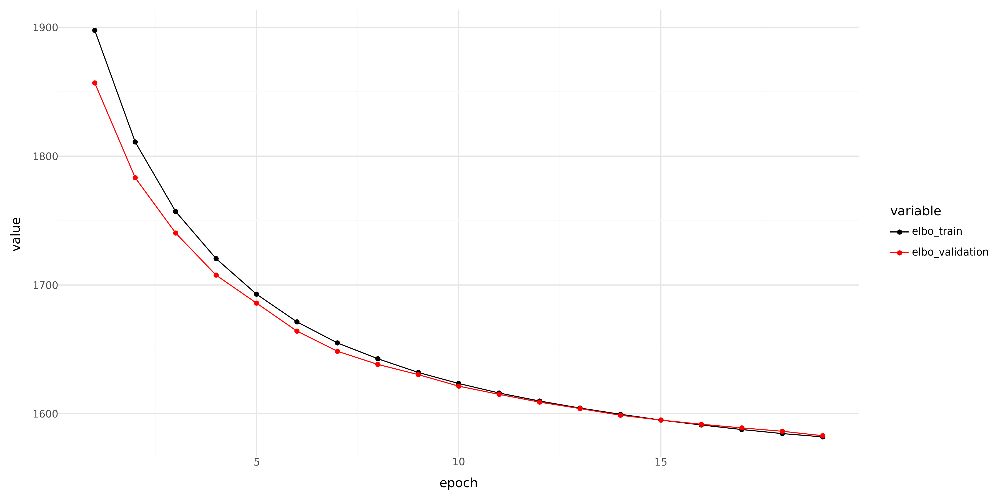

In [43]:
history_df = (
    scvi_model.history['elbo_train'].astype(float)
    .join(scvi_model.history['elbo_validation'].astype(float))
    .reset_index()
    .melt(id_vars = ['epoch'])
)

p.options.figure_size = 12, 6

p_ = (
    p.ggplot(p.aes(x = 'epoch', y = 'value', color = 'variable'), history_df.query('epoch > 0'))
    + p.geom_line()
    + p.geom_point()
    + p.scale_color_manual({'elbo_train': 'black', 'elbo_validation': 'red'})
    + p.theme_minimal()
)

p_.save('fig1.png', dpi = 300)

print(p_)

### Label transfer with `scANVI` 

In [44]:
scanvi_model = scvi.model.SCANVI.from_scvi_model(scvi_model, 'Unknown')

In [45]:
scanvi_model.train(40, 
                 check_val_every_n_epoch = 1, 
                 enable_progress_bar = True, 
                 accelerator = 'gpu',
                 devices = [1])

INFO     Training for 40 epochs.                                                                                   


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]


Epoch 40/40: 100%|██████████| 40/40 [19:29<00:00, 27.74s/it, v_num=1, train_loss_step=1.54e+3, train_loss_epoch=1.52e+3]

`Trainer.fit` stopped: `max_epochs=40` reached.


Epoch 40/40: 100%|██████████| 40/40 [19:29<00:00, 29.23s/it, v_num=1, train_loss_step=1.54e+3, train_loss_epoch=1.52e+3]


In [46]:
adata.obs["C_scANVI_new"] = scanvi_model.predict(adata)

- Extract latent representation

In [47]:
adata.obsm["X_scANVI"] = scanvi_model.get_latent_representation(adata)

### Explore model performance using the [_Svensson_](https://www.nxn.se/valent/2023/8/10/training-scvi-posterior-predictive-distributions-over-epochs) method

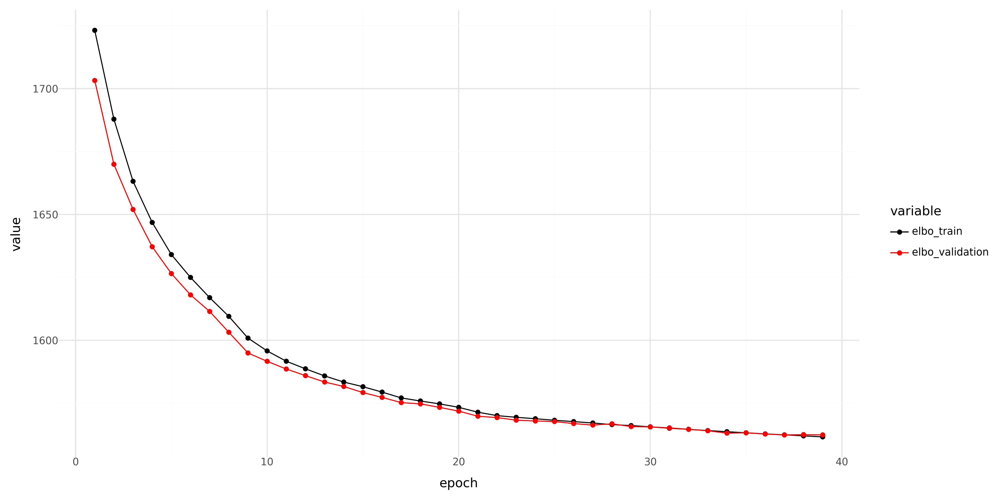

In [48]:
history_df = (
    scanvi_model.history['elbo_train'].astype(float)
    .join(scanvi_model.history['elbo_validation'].astype(float))
    .reset_index()
    .melt(id_vars = ['epoch'])
)

p.options.figure_size = 12, 6

p_ = (
    p.ggplot(p.aes(x = 'epoch', y = 'value', color = 'variable'), history_df.query('epoch > 0'))
    + p.geom_line()
    + p.geom_point()
    + p.scale_color_manual({'elbo_train': 'black', 'elbo_validation': 'red'})
    + p.theme_minimal()
)

p_.save('fig1.png', dpi = 300)

print(p_)

- Visualise corrected dataset

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:23)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:02:20)


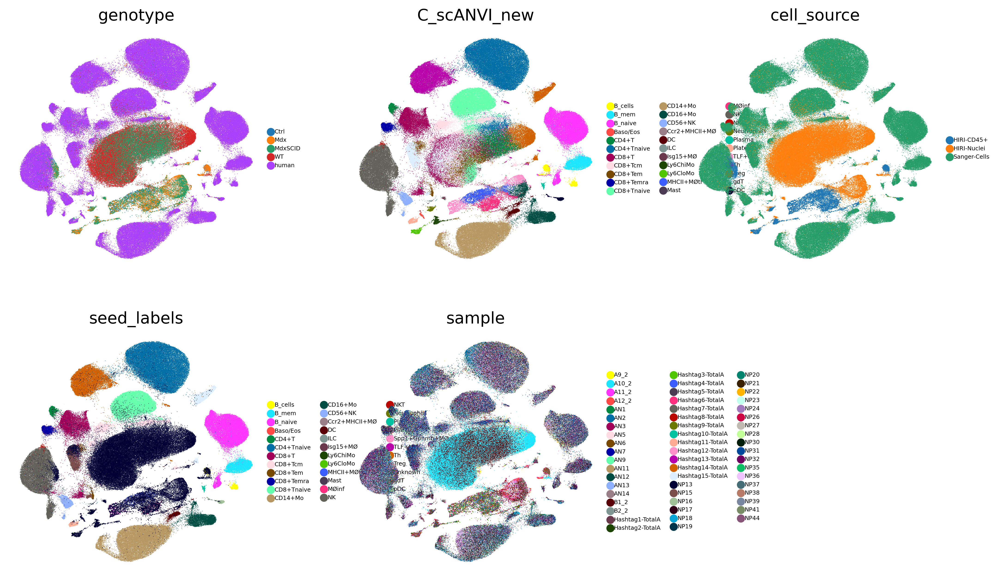

In [49]:
sc.pp.neighbors(adata, use_rep = "X_scANVI", n_neighbors = 50, metric = 'minkowski')
sc.tl.umap(adata, min_dist = 0.6, spread = 6, random_state = 1712)
sc.pl.umap(adata, frameon = False, color = ['genotype', 'C_scANVI_new', 'cell_source', 'seed_labels', 'sample'], size = 0.8, legend_fontsize = 5, ncols = 3)

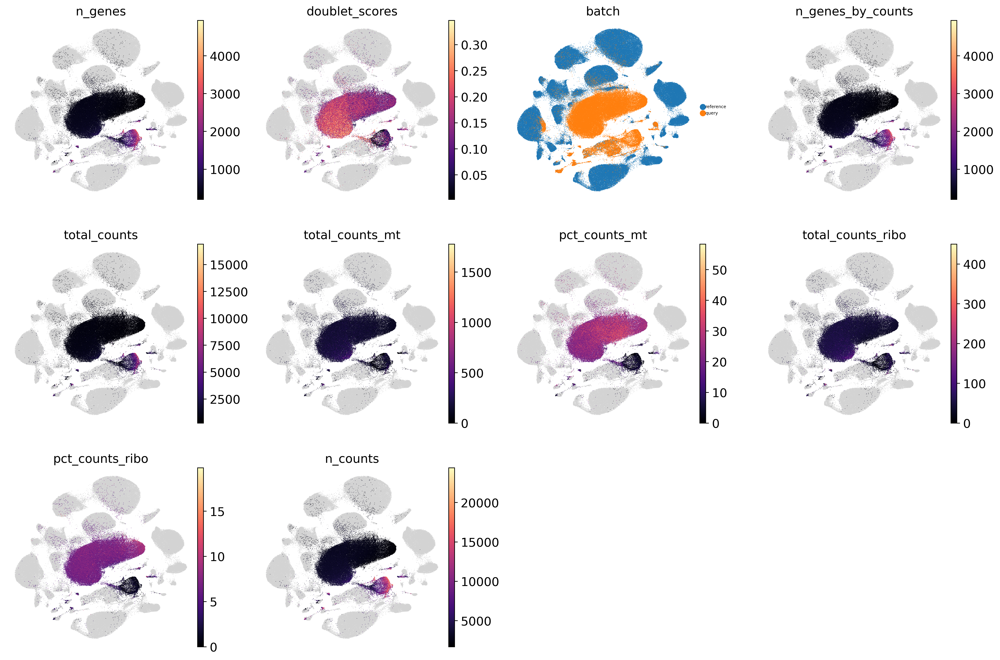

In [50]:
sc.pl.umap(adata, frameon = False, color = ['n_genes', 'doublet_scores', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'n_counts'], size = 1, legend_fontsize = 5, ncols = 4, cmap = 'magma')

### Modify object to plot canonical marker genes

In [51]:
adata_toplot = anndata.AnnData(X = np.sqrt(sc.pp.normalize_total(adata_raw, inplace = False)["X"]), var = adata_raw.var, obs = adata.obs, obsm = adata.obsm)
adata_toplot

normalizing counts per cell
    finished (0:00:00)


AnnData object with n_obs × n_vars = 254210 × 16060
    obs: 'orig.ident', 'Age_group', 'BMI', 'COVID_severity', 'COVID_status', 'Ethnicity', 'Group', 'Sex', 'annotation_broad', 'annotation_detailed', 'sample_id', 'seed_labels', 'donor', 'cell_states', 'sample', 'cell_source', 'genotype', 'nCount_HTO', 'nFeature_HTO', 'HTO_classification', 'Library', 'CD45_Annotation', 'cell_type', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'scrublet_score', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'MPC_Annotation', 'compartment', 'C_scANVI_new'
    var: 'gene_ids-DMD_immune', 'feature_types-DMD_immune', 'genome-DMD_immune', 'mt-DMD_immune', 'ribo-DMD_immune', 'n_cells_by_counts-DMD_immune', 'mean_counts-DMD_immune', 'pct_dropout_by_counts-DMD_immune', 'total_counts-DMD_immune', 'vst.

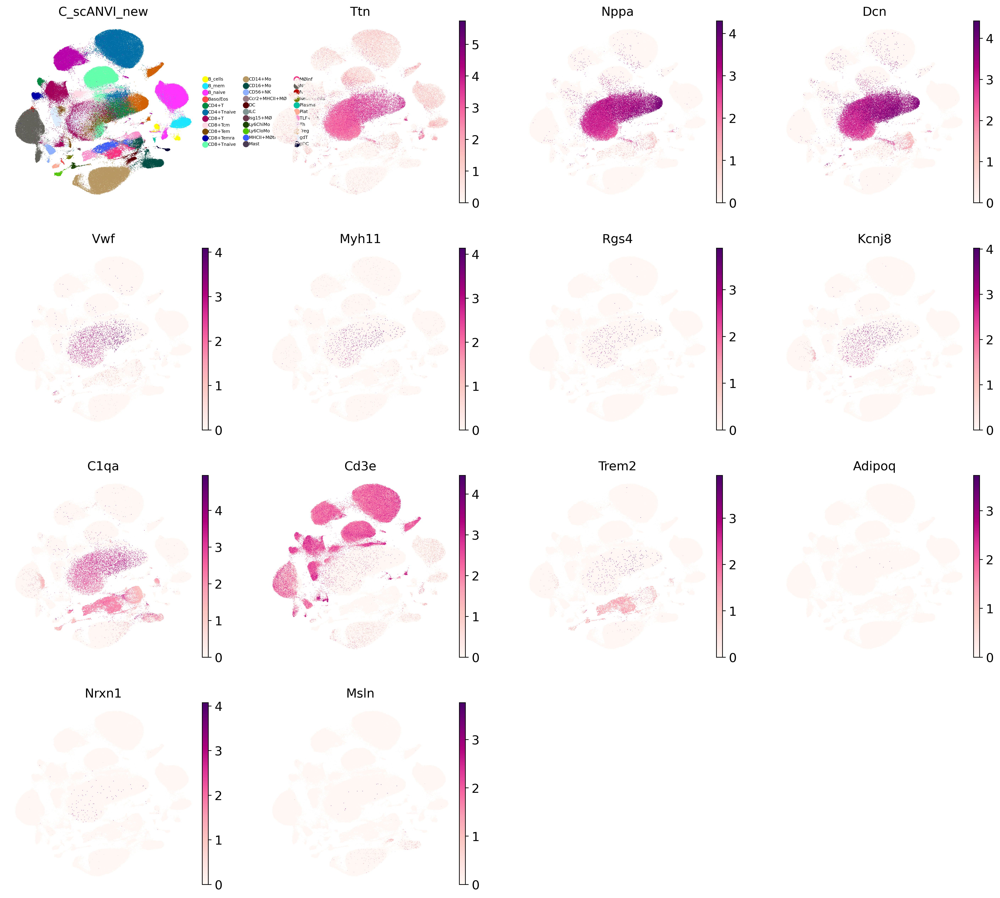

In [52]:
sc.pl.umap(adata_toplot, frameon = False, color = ['C_scANVI_new', 'Ttn', 'Nppa', 'Dcn', 'Vwf', 'Myh11', 'Rgs4', 'Kcnj8', 'C1qa', 'Cd3e', 'Trem2', 'Adipoq', 'Nrxn1', 'Msln'], size = 1, legend_fontsize = 5, ncols = 4, cmap = 'RdPu')

### Visualise proportions

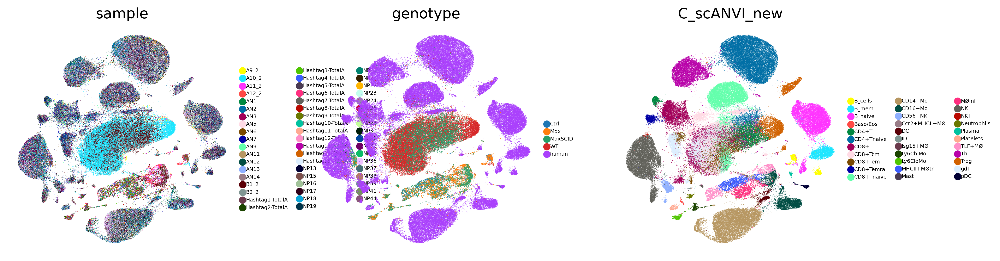

In [53]:
sc.pl.umap(adata, frameon = False, color = ['sample', 'genotype', 'C_scANVI_new'], size = 0.6, legend_fontsize = 5, ncols = 4)

In [54]:
bauhaus_colors = ['#FF0000', '#FFFF00', '#000000', '#4D5D53', '#0000FF', '#808080']

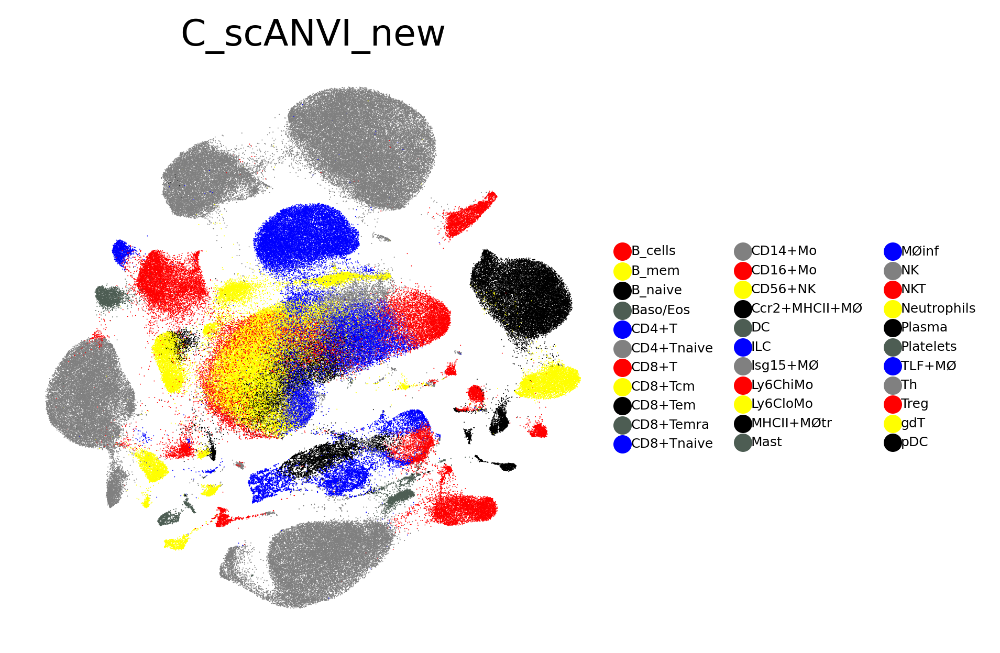

In [55]:
sc.pl.umap(adata, frameon = False, color = ['C_scANVI_new'], size = 0.6, legend_fontsize = 5, ncols = 4, palette = bauhaus_colors)

In [56]:
df = adata_toplot.obs.groupby(['genotype', 'C_scANVI_new']).size().reset_index(name = 'counts')

grouped = df.groupby('genotype')['counts'].apply(lambda x: x / x.sum() * 100)
grouped = grouped.reset_index()

df['proportions'] = grouped['counts']
df['waffle_counts'] = (df['proportions'] * 10).astype(int)

In [57]:
def generate_modified_bauhaus_palette(n_colors):
    # Define specific shades
    base_colors = [
        (1, 0, 0),      # Red
        (0.07, 0.04, 0.56),  # Ultramarine blue
        (0, 0.28, 0.67),  # Cobalt blue
        (1, 0.9, 0),  # Bauhaus yellow
        (0, 0, 0),  # Black
        (0.5, 0, 0.5),  # Purple
        (1, 0.55, 0),  # Orange
        (0.54, 0.17, 0.89),  # Violet
    ]

    # Create more distinct variations of each base color
    colors = []
    variation_steps = n_colors // len(base_colors) + 1
    for color in base_colors:
        for i in range(variation_steps):
            # Adjusting brightness and saturation
            variation = tuple(min(max(c * (0.8 + i * 0.1), 0), 1) for c in color)
            colors.append(variation)

    # Ensure we only use the number of colors needed
    unique_colors = []
    for color in colors:
        if color not in unique_colors:
            unique_colors.append(color)
        if len(unique_colors) == n_colors:
            break

    # Shuffle the unique colors
    np.random.shuffle(unique_colors)

    return unique_colors

# Generate the modified palette
bauhaus_palette = generate_modified_bauhaus_palette(18)

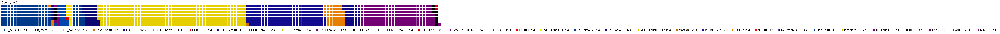

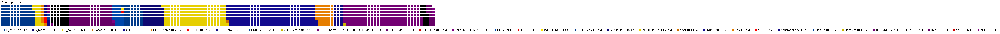

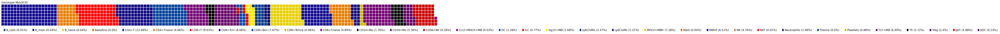

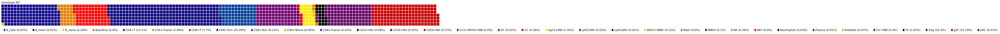

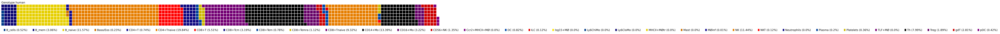

In [58]:
for group in df['genotype'].unique():
    temp_df = df[df['genotype'] == group]
    data = dict(zip(temp_df['C_scANVI_new'], temp_df['waffle_counts']))

    # Ensure the color list matches the number of cell types
    colors = [bauhaus_palette[i % len(bauhaus_palette)] for i in range(len(temp_df['C_scANVI_new']))]

    fig = plt.figure(
        FigureClass=Waffle, 
        rows=7, 
        values=data, 
        title={'label': f'Genotype {group}', 'loc': 'left', 'fontsize': 14},
        labels=[f"{k} ({v}%)" for k, v in zip(temp_df['C_scANVI_new'], temp_df['proportions'].round(2))],
        legend={'loc': 'lower left', 'bbox_to_anchor': (0, -0.4), 'ncol': len(data), 'framealpha': 0, 'fontsize': 14},
        figsize=(40, 4),
        colors=colors
    )
    plt.show()

### Export annotated sample object 

In [59]:
#adata.obs.index = pd.Index(['-'.join(idx.split('-')[:2]) for idx in adata.obs.index])
adata.obs.index

Index(['CV001_KM10202384-CV001_KM10202394_AAACCTGAGGCAGGTT-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGAGTGTCCCG-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGCAGATGGGT-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGGTATAGTAG-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGGTGTGCGTC-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGGTTAAGTAG-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGGTTAGATGA-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGTCATTTGGG-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGTCCGAAGAG-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGTCTGCTTGC-1-pbmc_meyer-reference',
       ...
       'TTTGATCCATAACAGA-1_2-MDX_MPC-query',
       'TTTGATCGTCGTATTG-1_2-MDX_MPC-query',
       'TTTGATCTCAAGTAAG-1_2-MDX_MPC-query',
       'TTTGGA

In [60]:
#adata_raw.obs.index = pd.Index(['-'.join(idx.split('-')[:2]) for idx in adata_raw.obs.index])
adata_raw.obs.index

Index(['CV001_KM10202384-CV001_KM10202394_AAACCTGAGGCAGGTT-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGAGTGTCCCG-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGCAGATGGGT-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGGTATAGTAG-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGGTGTGCGTC-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGGTTAAGTAG-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGGTTAGATGA-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGTCATTTGGG-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGTCCGAAGAG-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGTCTGCTTGC-1-pbmc_meyer-reference',
       ...
       'TTTGATCCATAACAGA-1_2-MDX_MPC-query',
       'TTTGATCGTCGTATTG-1_2-MDX_MPC-query',
       'TTTGATCTCAAGTAAG-1_2-MDX_MPC-query',
       'TTTGGA

In [61]:
adata.obs_names

Index(['CV001_KM10202384-CV001_KM10202394_AAACCTGAGGCAGGTT-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGAGTGTCCCG-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGCAGATGGGT-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGGTATAGTAG-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGGTGTGCGTC-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGGTTAAGTAG-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGGTTAGATGA-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGTCATTTGGG-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGTCCGAAGAG-1-pbmc_meyer-reference',
       'CV001_KM10202384-CV001_KM10202394_AAACCTGTCTGCTTGC-1-pbmc_meyer-reference',
       ...
       'TTTGATCCATAACAGA-1_2-MDX_MPC-query',
       'TTTGATCGTCGTATTG-1_2-MDX_MPC-query',
       'TTTGATCTCAAGTAAG-1_2-MDX_MPC-query',
       'TTTGGA

- Fix label for cell annotation

In [62]:
adata.obs['cell_type'] = adata.obs['C_scANVI_new'].copy()
adata.obs['cell_type'] = adata.obs['cell_type'].astype('category')
adata.obs['cell_type'].cat.categories

Index(['B_cells', 'B_mem', 'B_naive', 'Baso/Eos', 'CD4+T', 'CD4+Tnaive',
       'CD8+T', 'CD8+Tcm', 'CD8+Tem', 'CD8+Temra', 'CD8+Tnaive', 'CD14+Mo',
       'CD16+Mo', 'CD56+NK', 'Ccr2+MHCII+MØ', 'DC', 'ILC', 'Isg15+MØ',
       'Ly6ChiMo', 'Ly6CloMo', 'MHCII+MØtr', 'Mast', 'MØinf', 'NK', 'NKT',
       'Neutrophils', 'Plasma', 'Platelets', 'TLF+MØ', 'Th', 'Treg', 'gdT',
       'pDC'],
      dtype='object')

In [63]:
adata.obs['cell_type'].value_counts()

cell_type
CD4+Tnaive       36953
CD14+Mo          23854
CD8+Tnaive       21740
NK               21409
B_naive          20214
CD8+Tcm          19674
Th               15480
CD8+T            15103
gdT              13330
CD4+T            10256
Treg              8936
CD16+Mo           7555
CD8+Tem           6898
B_mem             5288
MHCII+MØtr        4132
MØinf             3789
TLF+MØ            3649
CD56+NK           2569
B_cells           2020
CD8+Temra         1962
DC                1950
Isg15+MØ          1758
Ly6ChiMo           948
Platelets          850
Ly6CloMo           803
pDC                779
Neutrophils        737
ILC                546
Baso/Eos           406
Plasma             355
NKT                204
Ccr2+MHCII+MØ       37
Mast                26
Name: count, dtype: int64

### Prepare object for export

In [64]:
adata_query = adata[adata.obs['compartment'].isin(['MDX_POOL_NEW', 'DMD_immune', 'MDX_MPC'])]
adata_query

View of AnnData object with n_obs × n_vars = 81644 × 8000
    obs: 'orig.ident', 'Age_group', 'BMI', 'COVID_severity', 'COVID_status', 'Ethnicity', 'Group', 'Sex', 'annotation_broad', 'annotation_detailed', 'sample_id', 'seed_labels', 'donor', 'cell_states', 'sample', 'cell_source', 'genotype', 'nCount_HTO', 'nFeature_HTO', 'HTO_classification', 'Library', 'CD45_Annotation', 'cell_type', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'scrublet_score', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'MPC_Annotation', 'compartment', 'C_scANVI_new'
    var: 'gene_ids-DMD_immune', 'feature_types-DMD_immune', 'genome-DMD_immune', 'mt-DMD_immune', 'ribo-DMD_immune', 'n_cells_by_counts-DMD_immune', 'mean_counts-DMD_immune', 'pct_dropout_by_counts-DMD_immune', 'total_counts-DMD_immune',

In [65]:
pd.crosstab(adata_query.obs['cell_type'], adata_query.obs['genotype'])

genotype,Ctrl,Mdx,MdxSCID,WT
cell_type,,,,
B_cells,467,632,2,27
B_mem,0,1,7,4
B_naive,3,147,7,91
Baso/Eos,0,1,0,0
CD4+T,1,8,2499,6474
CD4+Tnaive,15,63,918,1726
CD8+T,0,18,1778,3805
CD8+Tcm,25,51,1591,12497
CD8+Tem,5,19,1510,4012


### Export annotated object with raw counts

In [66]:
adata_query.obs.index = pd.Index(['-'.join(idx.split('-')[:3]) for idx in adata_query.obs.index])
adata_query.obs_names

Index(['AAACCCAGTCAAGCGA-1_1-MDX_POOL_NEW',
       'AAACCCAGTGGCTTGC-1_1-MDX_POOL_NEW',
       'AAACGCTGTAGTTACC-1_1-MDX_POOL_NEW',
       'AAACGCTGTTATAGAG-1_1-MDX_POOL_NEW',
       'AAAGAACTCCCGTGTT-1_1-MDX_POOL_NEW',
       'AAAGGATGTTATCTGG-1_1-MDX_POOL_NEW',
       'AAAGGATTCGTAGTCA-1_1-MDX_POOL_NEW',
       'AAAGGGCTCTAACACG-1_1-MDX_POOL_NEW',
       'AAAGGTATCTATTCGT-1_1-MDX_POOL_NEW',
       'AAAGTCCGTGGACCAA-1_1-MDX_POOL_NEW',
       ...
       'TTTGATCCATAACAGA-1_2-MDX_MPC', 'TTTGATCGTCGTATTG-1_2-MDX_MPC',
       'TTTGATCTCAAGTAAG-1_2-MDX_MPC', 'TTTGGAGAGACTAAGT-1_2-MDX_MPC',
       'TTTGGAGAGCGACTGA-1_2-MDX_MPC', 'TTTGGAGAGGATAATC-1_2-MDX_MPC',
       'TTTGGAGTCTCGGCTT-1_2-MDX_MPC', 'TTTGGTTTCCATAGAC-1_2-MDX_MPC',
       'TTTGTTGAGATTCGAA-1_2-MDX_MPC', 'TTTGTTGGTGATATAG-1_2-MDX_MPC'],
      dtype='object', length=81644)

In [67]:
adata_export_raw.obs.index = pd.Index(['-'.join(idx.split('-')[:3]) for idx in adata_export_raw.obs.index])
adata_export_raw.obs_names

Index(['ACCCTTGAGAATCGTA-1-A9_2', 'AGGATCTCAGCCTTCT-1-A9_2',
       'ATGCATGAGCTGACTT-1-A9_2', 'CACTTCGGTACCGGCT-1-A9_2',
       'GACCCTTTCTTAGTTC-1-A9_2', 'AGCTACATCCTCGCAT-1-A9_2',
       'TACAGGTAGAGCCGAT-1-A9_2', 'AGGATCTTCTCTCGCA-1-A9_2',
       'GGTTCTCCAGCTTCCT-1-A9_2', 'GACTTCCTCCGTAGTA-1-A9_2',
       ...
       'TTTGGAGAGACTAAGT-1_2-MDX_MPC', 'TTTGGAGAGCGACTGA-1_2-MDX_MPC',
       'TTTGGAGAGGATAATC-1_2-MDX_MPC', 'TTTGGAGAGTAGGATT-1_2-MDX_MPC',
       'TTTGGAGTCTCGGCTT-1_2-MDX_MPC', 'TTTGGTTTCCATAGAC-1_2-MDX_MPC',
       'TTTGTTGAGATTCGAA-1_2-MDX_MPC', 'TTTGTTGAGTGTTGTC-1_2-MDX_MPC',
       'TTTGTTGCAGGCCCTA-1_2-MDX_MPC', 'TTTGTTGGTGATATAG-1_2-MDX_MPC'],
      dtype='object', length=83169)

In [68]:
common_obs_names = adata_export_raw.obs_names[adata_export_raw.obs_names.isin(adata_query.obs_names)]
adata_subset = adata_export_raw[common_obs_names]
adata_subset

View of AnnData object with n_obs × n_vars = 81644 × 27478
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI', 'nCount_RNA', 'nFeature_RNA', 'nCount_HTO', 'nFeature_HTO', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'hash.ID', 'nCount_ADT', 'nFeature_ADT', 'percent.mt', 'Library', 'Sample', 'Condition', 'RNA_snn_res.0.2', 'seurat_clusters', 'CD45_Annotation', 'RNA_snn_res.0.3', 'RNA_snn_res.0.5', 'MPC_Annotation', 'data_sourcecompartment'
    var: 'gene_ids-DMD_immune', 'feature_types-DMD_immune', 'genome-DMD_immune', 'mt-DMD_immune', 'ribo-DMD_immune', 'n_cells_by_counts-DMD_immune', 'mean_

In [69]:
adata_subset

View of AnnData object with n_obs × n_vars = 81644 × 27478
    obs: 'cell_source', 'cell_type', 'donor', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'cell_states', 'seed_labels', 'genotype', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'C_scANVI', 'nCount_RNA', 'nFeature_RNA', 'nCount_HTO', 'nFeature_HTO', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'hash.ID', 'nCount_ADT', 'nFeature_ADT', 'percent.mt', 'Library', 'Sample', 'Condition', 'RNA_snn_res.0.2', 'seurat_clusters', 'CD45_Annotation', 'RNA_snn_res.0.3', 'RNA_snn_res.0.5', 'MPC_Annotation', 'data_sourcecompartment'
    var: 'gene_ids-DMD_immune', 'feature_types-DMD_immune', 'genome-DMD_immune', 'mt-DMD_immune', 'ribo-DMD_immune', 'n_cells_by_counts-DMD_immune', 'mean_

In [70]:
adata_export = anndata.AnnData(X = adata_subset.X, obs = adata_query.obs, var = adata_subset.var)
adata_export

AnnData object with n_obs × n_vars = 81644 × 27478
    obs: 'orig.ident', 'Age_group', 'BMI', 'COVID_severity', 'COVID_status', 'Ethnicity', 'Group', 'Sex', 'annotation_broad', 'annotation_detailed', 'sample_id', 'seed_labels', 'donor', 'cell_states', 'sample', 'cell_source', 'genotype', 'nCount_HTO', 'nFeature_HTO', 'HTO_classification', 'Library', 'CD45_Annotation', 'cell_type', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'scrublet_score', 'batch', 'doublet_scores', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', '_scvi_batch', '_scvi_labels', 'MPC_Annotation', 'compartment', 'C_scANVI_new'
    var: 'gene_ids-DMD_immune', 'feature_types-DMD_immune', 'genome-DMD_immune', 'mt-DMD_immune', 'ribo-DMD_immune', 'n_cells_by_counts-DMD_immune', 'mean_counts-DMD_immune', 'pct_dropout_by_counts-DMD_immune', 'total_counts-DMD_immune', 'vst.m

In [71]:
pd.crosstab(adata_query.obs['cell_type'], adata_query.obs['genotype'])

genotype,Ctrl,Mdx,MdxSCID,WT
cell_type,,,,
B_cells,467,632,2,27
B_mem,0,1,7,4
B_naive,3,147,7,91
Baso/Eos,0,1,0,0
CD4+T,1,8,2499,6474
CD4+Tnaive,15,63,918,1726
CD8+T,0,18,1778,3805
CD8+Tcm,25,51,1591,12497
CD8+Tem,5,19,1510,4012


In [72]:
adata_export.write('../../data/heart_mm_nuclei-23-0092_scANVI-Immune_ctl240329.raw.h5ad')